In [2]:
import torch
from torch import nn
from torch.optim import Adam, NAdam
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader
import os
import cv2
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import random
import numpy as np

%load_ext autoreload
%autoreload 2
%matplotlib inline

In [3]:
def random_noise(batch_size, channels, side_size):
    return torch.randn(batch_size, channels, side_size, side_size).cuda()

In [4]:
def visualise(imgs, rows=2):
    imgs = (imgs.transpose(1, 3) + 1) / 2
    imgs = torch.cat([imgs[i::rows] for i in range(rows)], dim=1)
    cols = len(imgs)
    imgs = (torch.cat(list(imgs), dim=1)).cpu().numpy()[:, :, ::-1]
    plt.figure(figsize=(cols*1.5, rows*1.5))
    plt.imshow(imgs)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

In [5]:
class CatDataset(Dataset):
    def __init__(self, path_to_dataset="/kaggle/input/cats-136/cat_136", size=64):
        self.photo_names = os.listdir(path_to_dataset)
        self.path_base = path_to_dataset
        self.size = size

    def __getitem__(self, index):
        path = self.path_base + "/" + self.photo_names[index]
        img = cv2.imread(path) # 136 x 136
        crop_rate = 8
        x_crop = random.randint(0, crop_rate)
        y_crop = random.randint(0, crop_rate)
        img = img[x_crop:136 - crop_rate + x_crop, y_crop:136 - crop_rate + y_crop]
        img = cv2.resize(img, (self.size, self.size), interpolation=cv2.INTER_CUBIC)
        return 2 * torch.tensor(img).float().transpose(0, 2) / 255. - 1

    def __len__(self):
        return len(self.photo_names)

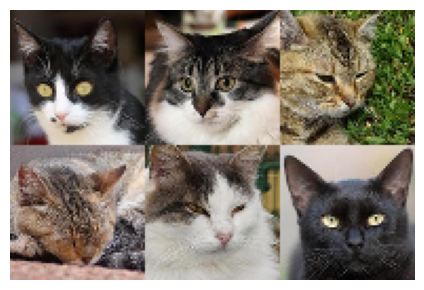

In [6]:
dataset = CatDataset()
visualise(torch.cat([dataset[i].unsqueeze(0) for i in [3, 15, 182, 592, 394, 2941]], dim=0))

In [26]:
vae = VAE(img_size=128, downsamplings=5, latent_size=128, down_channels=8, up_channels=13)

In [11]:
vae = VAE(img_size=128, downsamplings=6, latent_size=512, down_channels=30, up_channels=45)

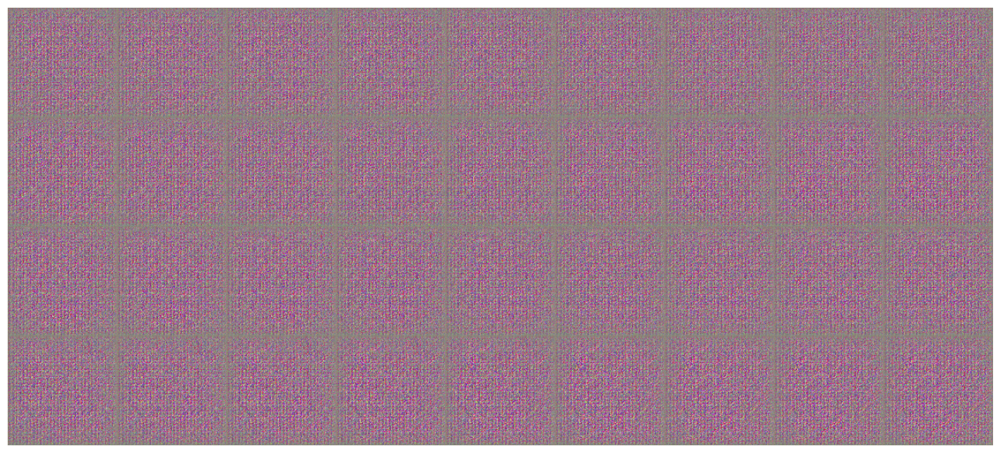

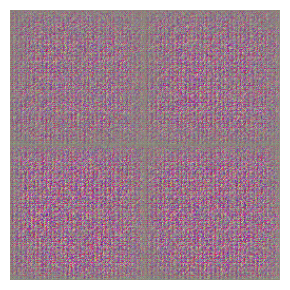

  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 1 | Reconstruction loss: 7586.769898883668 | KLD loss: 366.54071360590297


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 2 | Reconstruction loss: 5339.965548286349 | KLD loss: 428.06494923127


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 3 | Reconstruction loss: 4879.255466701267 | KLD loss: 447.60891538677794


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 4 | Reconstruction loss: 4610.336418952142 | KLD loss: 465.32529070660786


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 5 | Reconstruction loss: 4409.232947147254 | KLD loss: 478.4384041454964


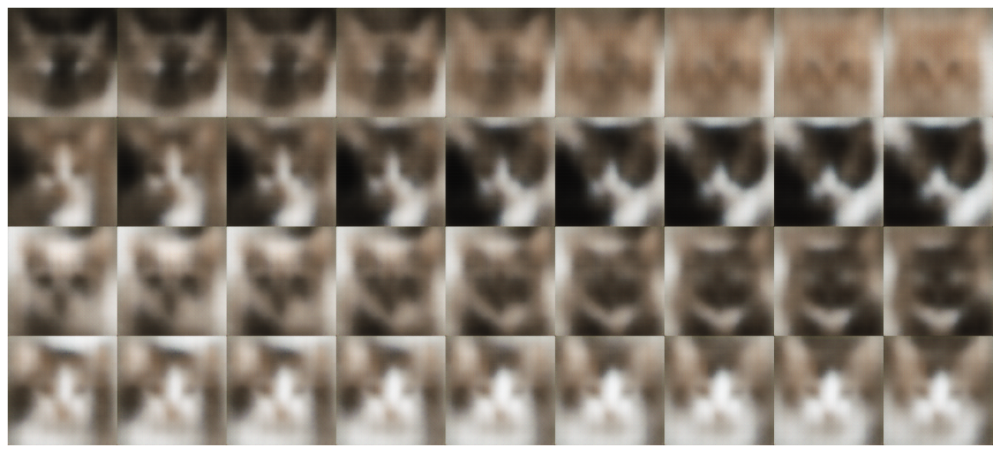

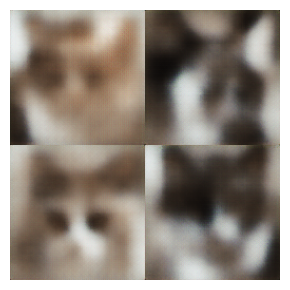

  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 6 | Reconstruction loss: 4140.679525308676 | KLD loss: 491.1338464696924


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 7 | Reconstruction loss: 3950.9980673623254 | KLD loss: 498.70455228365387


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 8 | Reconstruction loss: 3818.1831589634326 | KLD loss: 496.8426332273683


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 9 | Reconstruction loss: 3720.6140005827506 | KLD loss: 497.19007869978327


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 10 | Reconstruction loss: 3638.7616692389643 | KLD loss: 497.00578418367115


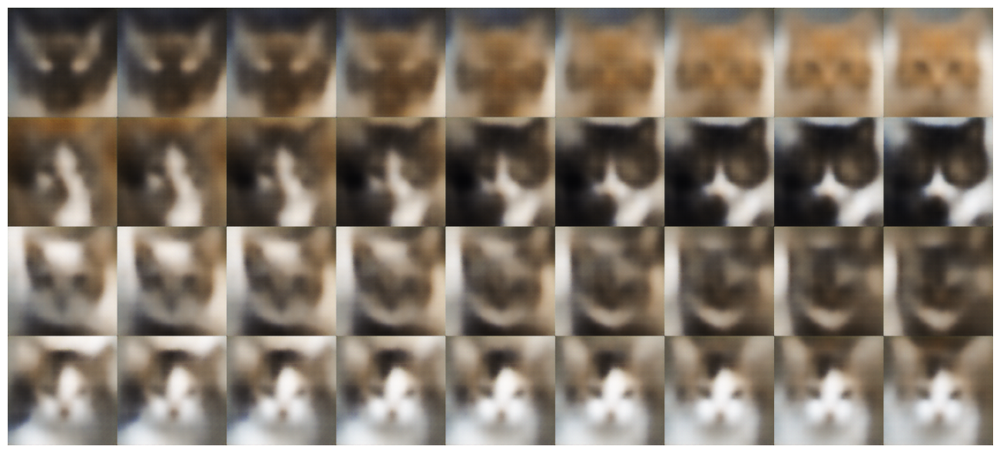

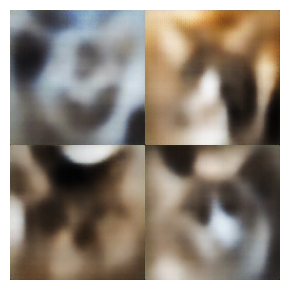

  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 11 | Reconstruction loss: 3564.0531099759614 | KLD loss: 500.9905708508614


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 12 | Reconstruction loss: 3481.959620620265 | KLD loss: 498.8649881714152


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 13 | Reconstruction loss: 3443.6550150695657 | KLD loss: 496.185187635444


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 14 | Reconstruction loss: 3399.254227502641 | KLD loss: 494.98824881173516


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 15 | Reconstruction loss: 3342.619123552229 | KLD loss: 496.4876501977027


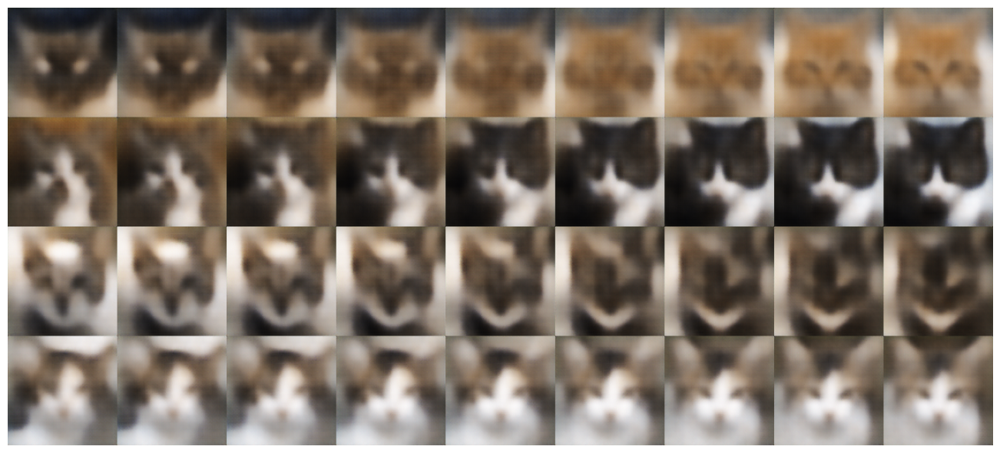

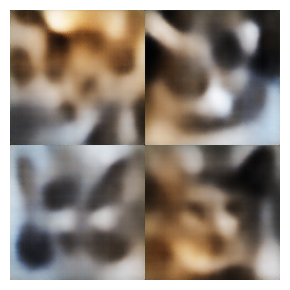

  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 16 | Reconstruction loss: 3312.975066925262 | KLD loss: 493.7190619337531


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 17 | Reconstruction loss: 3265.6498903928104 | KLD loss: 492.29511835413933


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 18 | Reconstruction loss: 3227.6577842730185 | KLD loss: 493.26652388139206


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 19 | Reconstruction loss: 3212.8583648610506 | KLD loss: 492.3035914281032


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 20 | Reconstruction loss: 3175.8726621685605 | KLD loss: 492.5523532253879


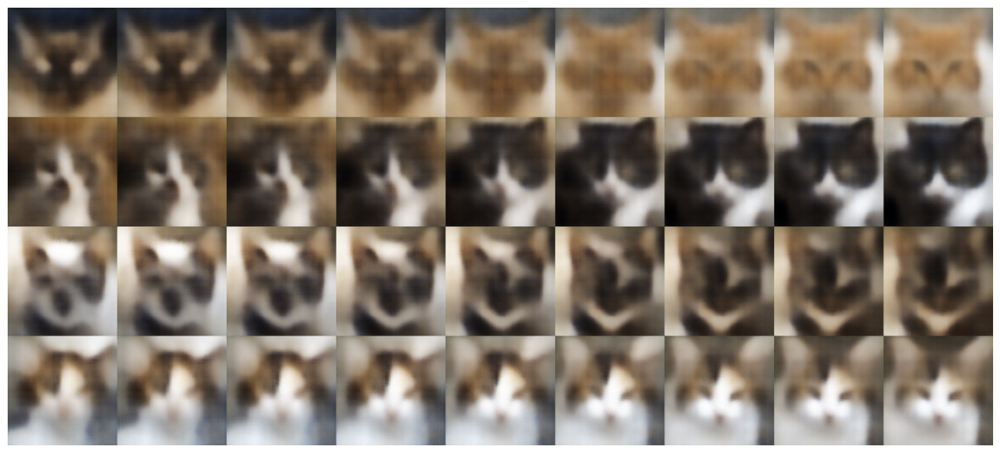

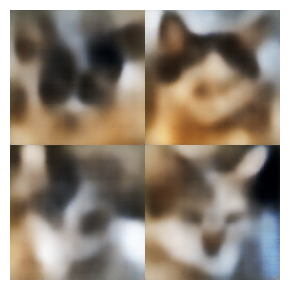

  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 21 | Reconstruction loss: 3162.8550015251676 | KLD loss: 493.37250922498725


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 22 | Reconstruction loss: 3147.6008511345426 | KLD loss: 495.4949936944566


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 23 | Reconstruction loss: 3116.5327794357336 | KLD loss: 494.3159884650668


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 24 | Reconstruction loss: 3087.2617597246503 | KLD loss: 492.8383099038006


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 25 | Reconstruction loss: 3069.723385257321 | KLD loss: 491.51871061880826


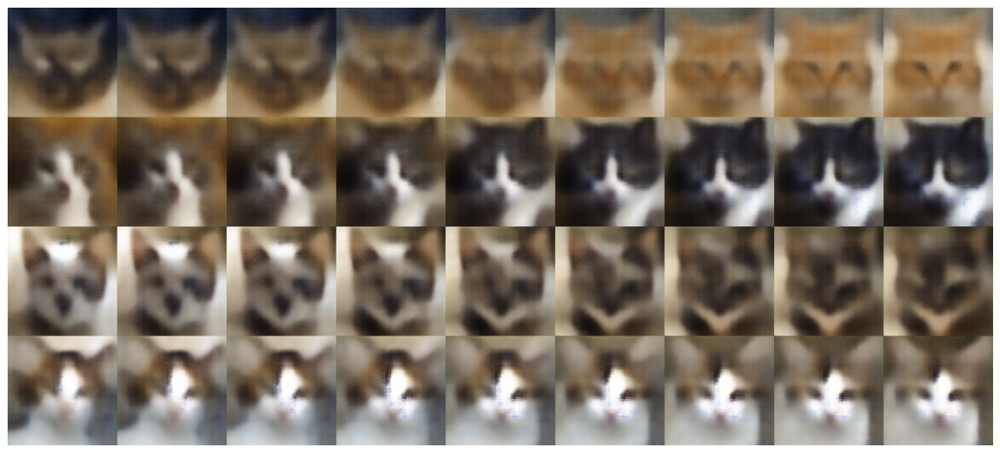

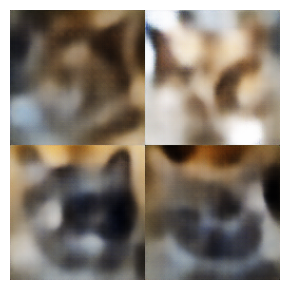

  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 26 | Reconstruction loss: 3050.563177789008 | KLD loss: 492.2499838520041


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 27 | Reconstruction loss: 3033.8293678977275 | KLD loss: 491.72696001101764


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 28 | Reconstruction loss: 3002.545727425244 | KLD loss: 489.538070429733


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 29 | Reconstruction loss: 2982.9390516303356 | KLD loss: 489.76326988238


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 30 | Reconstruction loss: 2987.8409358382505 | KLD loss: 489.787974751079


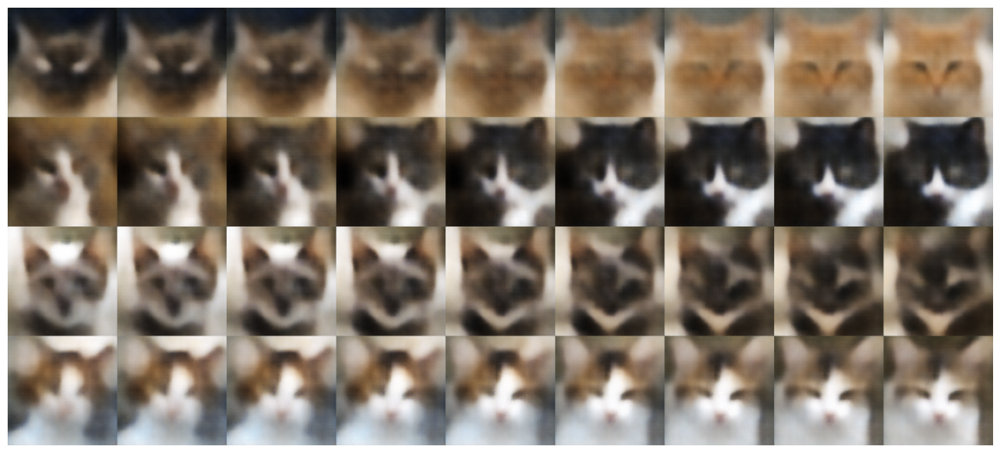

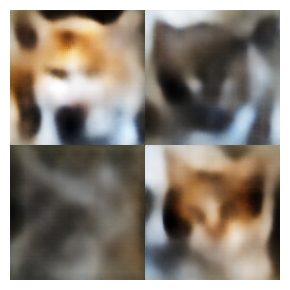

  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 31 | Reconstruction loss: 2952.072716346154 | KLD loss: 486.53426419771637


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 32 | Reconstruction loss: 2943.5189046793053 | KLD loss: 489.2805872208033


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 33 | Reconstruction loss: 2946.483327016408 | KLD loss: 486.5825526097438


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 34 | Reconstruction loss: 2906.934447388549 | KLD loss: 483.43056489815524


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 35 | Reconstruction loss: 2930.666259196533 | KLD loss: 485.99879508918815


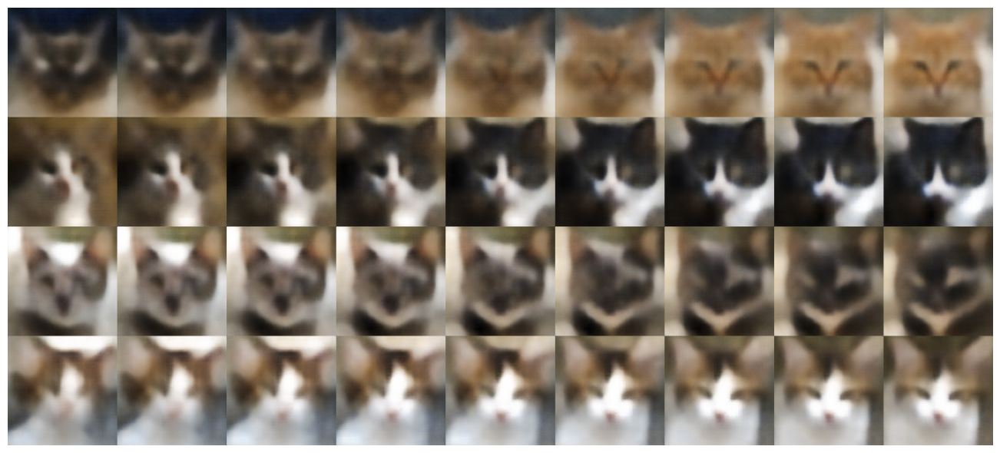

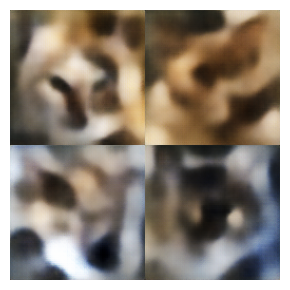

  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 36 | Reconstruction loss: 2893.122217707423 | KLD loss: 483.8976333724869


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 37 | Reconstruction loss: 2894.1846286444675 | KLD loss: 484.41495561933186


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 38 | Reconstruction loss: 2878.009567865403 | KLD loss: 483.3624537896999


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 39 | Reconstruction loss: 2877.7532517937793 | KLD loss: 483.8601399312764


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 40 | Reconstruction loss: 2862.772626827925 | KLD loss: 481.12961832682294


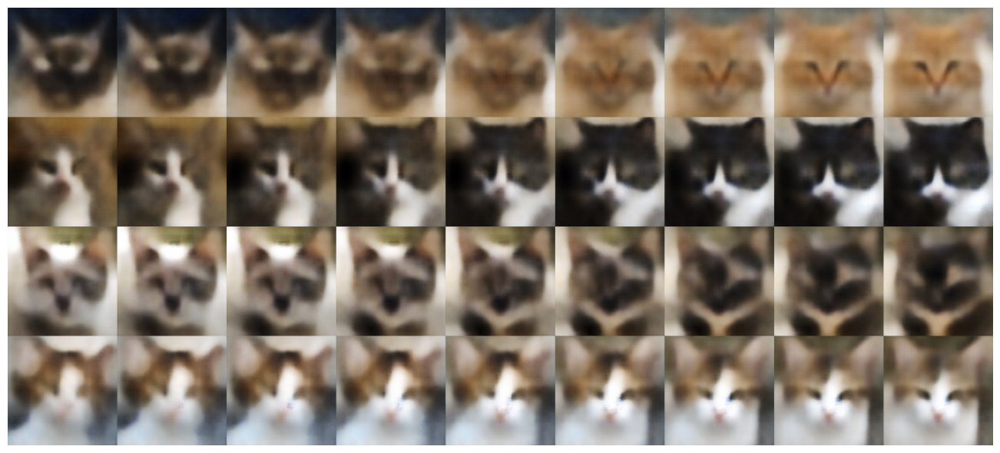

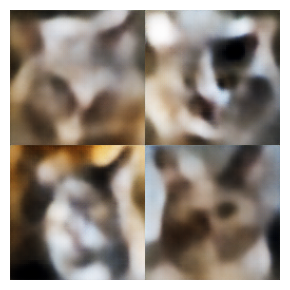

  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 41 | Reconstruction loss: 2839.874356356534 | KLD loss: 479.1767906064476


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 42 | Reconstruction loss: 2845.3668323863635 | KLD loss: 482.30082869807603


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 43 | Reconstruction loss: 2825.295135284637 | KLD loss: 478.1479187011719


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 44 | Reconstruction loss: 2822.4187253583004 | KLD loss: 479.8952017830802


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 45 | Reconstruction loss: 2810.3294828543853 | KLD loss: 478.19679171333223


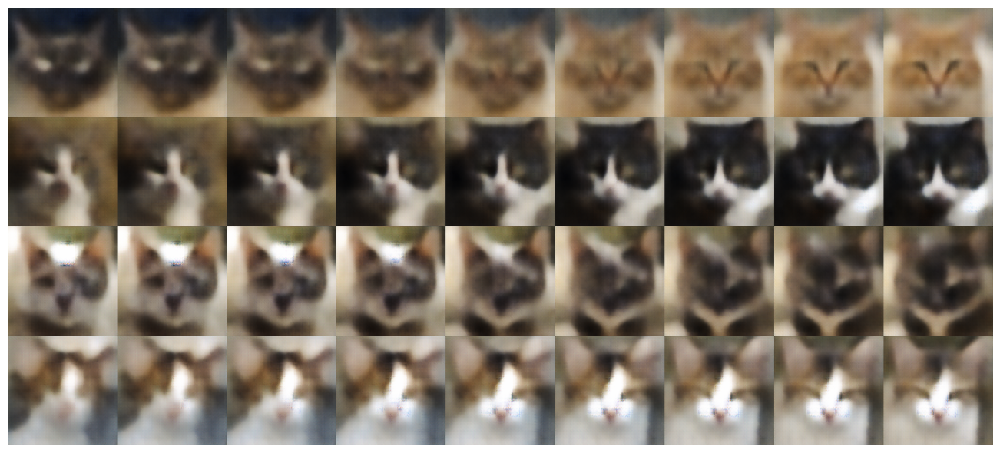

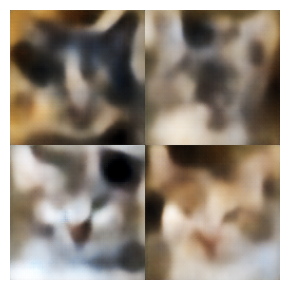

  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 46 | Reconstruction loss: 2811.4561736278047 | KLD loss: 478.5024182868726


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 47 | Reconstruction loss: 2790.447225503988 | KLD loss: 477.7766814687591


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 48 | Reconstruction loss: 2777.2542915255317 | KLD loss: 477.47490039460865


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 49 | Reconstruction loss: 2782.248511823463 | KLD loss: 477.9105265157206


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 50 | Reconstruction loss: 2777.891435102983 | KLD loss: 476.07284745080767


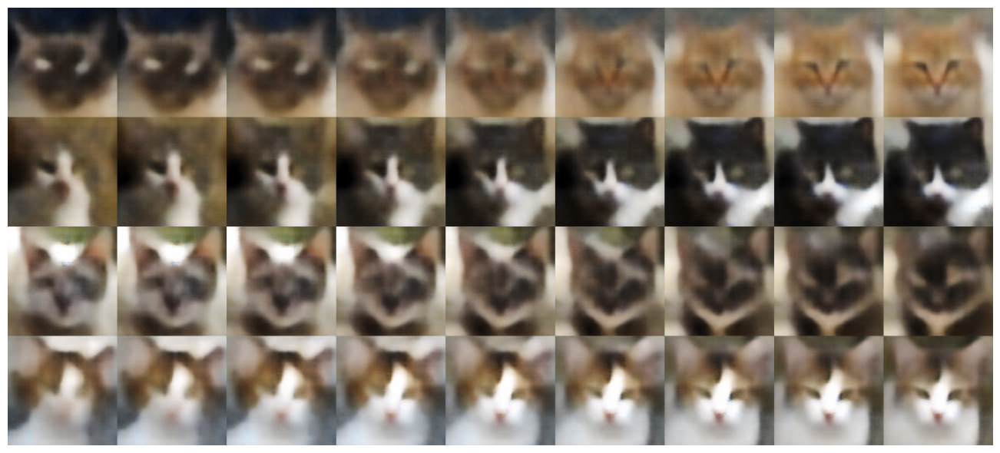

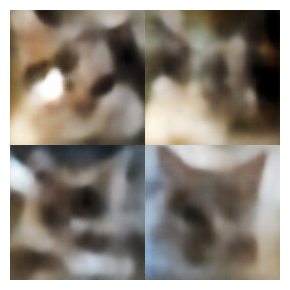

  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 51 | Reconstruction loss: 2767.3629099172313 | KLD loss: 476.01968077901915


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 52 | Reconstruction loss: 2771.2778166657563 | KLD loss: 475.7603574810606


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 53 | Reconstruction loss: 2749.925162646598 | KLD loss: 474.76293731902865


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 54 | Reconstruction loss: 2740.021861967785 | KLD loss: 475.1224579355378


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 55 | Reconstruction loss: 2724.40162583998 | KLD loss: 472.21693608922004


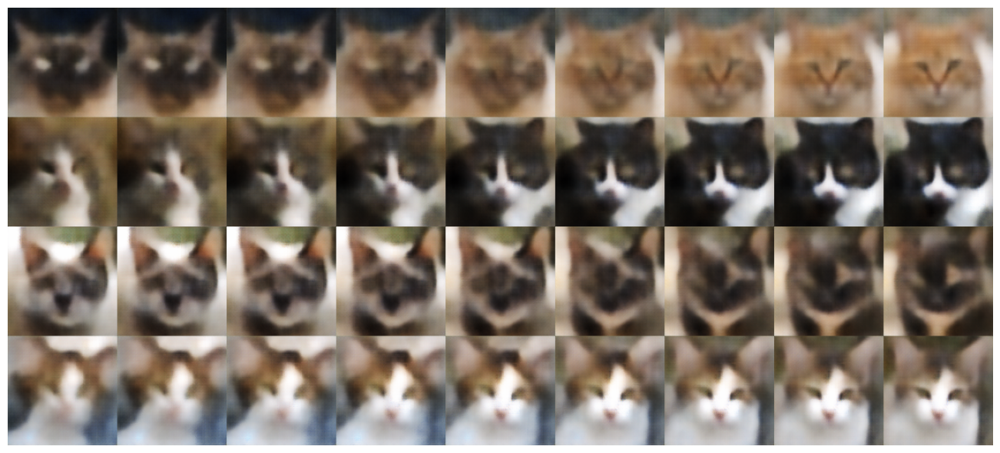

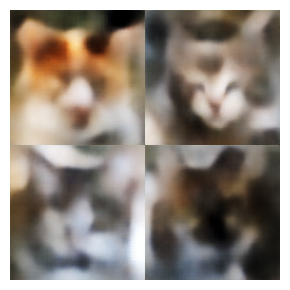

  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 56 | Reconstruction loss: 2698.760163989656 | KLD loss: 471.49181766109865


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 57 | Reconstruction loss: 2720.568013651388 | KLD loss: 472.2143457230432


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 58 | Reconstruction loss: 2696.376122534692 | KLD loss: 470.6693130884415


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 59 | Reconstruction loss: 2695.993153249745 | KLD loss: 470.7429623903928


  0%|          | 0/430 [00:00<?, ?it/s]

Epoch 60 | Reconstruction loss: 2686.2401598239003 | KLD loss: 470.0414244467284


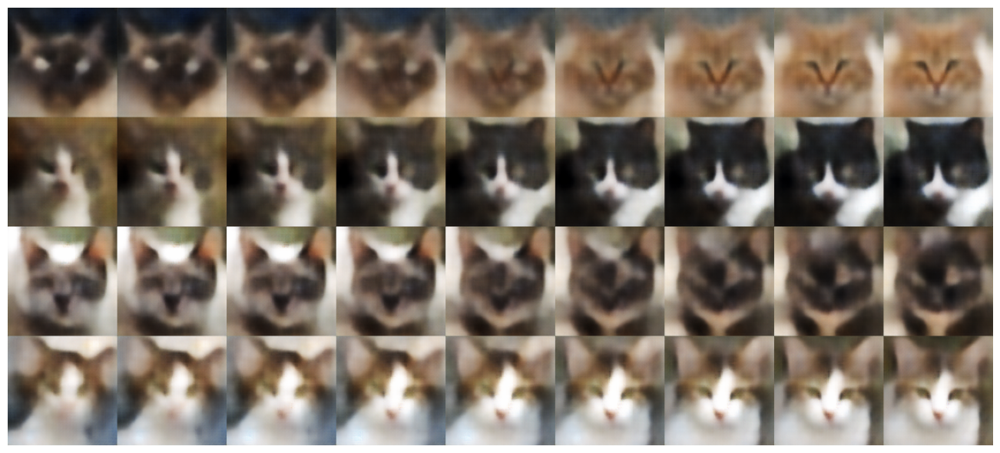

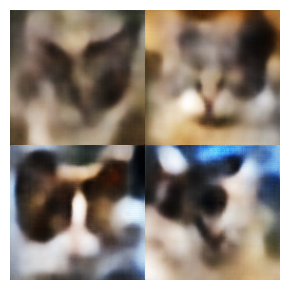

  0%|          | 0/430 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [27]:
def train_vae():
    vae.cuda()

    epochs = 200
    batch_size = 12
    vae_optim = NAdam(vae.parameters(), lr=0.0004)

    dataset = CatDataset(size=128)

    test_imgs_1 = torch.cat([dataset[i].unsqueeze(0) for i in (0, 34, 76, 1509)])
    test_imgs_2 = torch.cat([dataset[i].unsqueeze(0) for i in (734, 123, 512, 3634)])

    for ep in range(epochs):
        dataloader = DataLoader(dataset, shuffle=True, batch_size=batch_size)
        total_batches = 0
        rec_loss_avg = 0
        kld_loss_avg = 0

        if ep % 5 == 0:
            with torch.no_grad():
                z_1 = vae.encode(test_imgs_1.cuda())
                z_2 = vae.encode(test_imgs_2.cuda())
                x_int = []
                for i in range(9):
                    z = (i * z_1 + (8 - i) * z_2) / 8
                    x_int.append(vae.decode(z))
                x_int = torch.cat(x_int)
                visualise(x_int, rows=len(test_imgs_1))
                z_rand = torch.randn_like(z_1)
                x_int = vae.decode(z_rand)
                visualise(x_int, rows=len(test_imgs_1)//2)

        for i, batch in tqdm(enumerate(dataloader), total=(len(dataset) + batch_size) // batch_size):
            if len(batch) < batch_size:
                continue
            total_batches += 1
            x = batch.cuda()
            x_rec, kld = vae(x)
            img_elems = float(np.prod(list(batch.size())))
            kld_loss = kld.sum() / batch_size
            rec_loss = ((x_rec - x)**2).sum() / batch_size
            loss = rec_loss + 0.1 * kld_loss # https://openreview.net/forum?id=Sy2fzU9gl
            vae_optim.zero_grad()
            loss.backward()
            vae_optim.step()
            kld_loss_avg += kld_loss.item()
            rec_loss_avg += rec_loss.item()

        print(f"Epoch {ep+1} | Reconstruction loss: {rec_loss_avg / total_batches} | KLD loss: {kld_loss_avg / total_batches}")

train_vae()

In [13]:
vae.save()

In [ ]:
with torch.no_grad():
    z_rand = torch.randn((64, 128)).cuda()
    x_int = vae.decode(z_rand)
    visualise(x_int, rows=16)